<a href="https://colab.research.google.com/github/mjgpinheiro/Physics_models/blob/main/Ergon_Crawl_3D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

BLOCK 1 OK


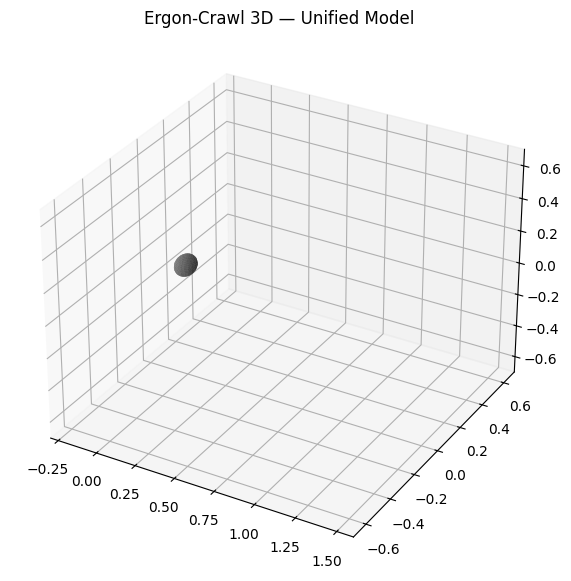

In [ ]:
# ============================================
# ERGON-CRAWL 3D — UNIFIED NOTEBOOK
# BLOCK 1 — Setup + Figure
# ============================================

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

# Sphere for head
def sphere(center, radius=0.06, resolution=20):
    u = np.linspace(0, 2*np.pi, resolution)
    v = np.linspace(0, np.pi, resolution)
    x = center[0] + radius*np.outer(np.cos(u), np.sin(v))
    y = center[1] + radius*np.outer(np.sin(u), np.sin(v))
    z = center[2] + radius*np.outer(np.ones_like(u), np.cos(v))
    return x, y, z

# Parameters
L = 1.8
N = 140
s = np.linspace(0, L, N)

amp_lat = 0.10
amp_vert = 0.015
wave_k = 2*np.pi / L
wave_freq = 1.7

twist_amp = 0.06
twist_freq = 2.3

breath_period = 3
breath_angle = np.radians(45)

upper_len = 0.32
lower_len = 0.27

leg_len_thigh = 0.35
leg_len_shin  = 0.25
leg_amp_base = 0.10
leg_freq = 3.2

fig = plt.figure(figsize=(11,7))
ax = fig.add_subplot(111, projection='3d')

ax.set_xlim(-0.3, 1.6)
ax.set_ylim(-0.7, 0.7)
ax.set_zlim(-0.7, 0.7)
ax.set_title("Ergon-Crawl 3D — Unified Model")

# Body line
torso_line, = ax.plot([], [], [], lw=3, color='black')

# Placeholder head
head_obj = ax.plot_surface(*sphere([0,0,0]), color='gray')

print("BLOCK 1 OK")


In [ ]:
# ============================================
# BLOCK 2 — Torso, Head, Arms, Legs
# ============================================

def compute_torso(t):
    Y = amp_lat * np.sin(wave_k*s - wave_freq*t)
    Z = amp_vert * np.sin(wave_k*s - wave_freq*t + np.pi/3)
    X = s.copy()

    roll = 0.25 * np.sin(0.5 * t)

    Yr = Y*np.cos(roll) - Z*np.sin(roll)
    Zr = Y*np.sin(roll) + Z*np.cos(roll)

    twist = twist_amp * np.sin(twist_freq*t + 0.5*s)
    Zr += 0.03 * twist

    return X, Yr, Zr, roll, twist

def compute_head(Xt, Yt, Zt, t):
    base = np.array([Xt[0], Yt[0], Zt[0]])

    cycle = (t % (2*np.pi)) / (2*np.pi)
    breathing = cycle < 0.20 and int(t // (2*np.pi)) % breath_period == 0

    head = base.copy()
    if breathing:
        head[1] += 0.08 * np.sin(breath_angle)
        head[2] += 0.08 * (1 - np.cos(breath_angle))

    return head

def compute_right_arm(Xt, Yt, Zt, t):
    sh = np.array([Xt[0] + 0.10, Yt[0] - 0.22, Zt[0]])
    phase = (t % (2*np.pi)) / (2*np.pi)

    if phase < 0.5:
        u = np.pi/6 + (np.pi/2)*phase*2
        f = np.pi/4 + (np.pi/3)*phase*2
        elbow = sh + np.array([ upper_len*np.cos(u), -0.10*np.sin(u), -0.10*np.sin(0.6*u) ])
        hand  = elbow + np.array([ lower_len*np.cos(f), -0.20*np.sin(f), -0.10*np.sin(0.7*f) ])
    else:
        p = (phase - 0.5)*2
        u = np.pi/2 - (np.pi/2)*p

        elbow = sh + np.array([ upper_len*np.cos(u), 0.15*p, 0.20*p ])
        hand = elbow + np.array([
            lower_len*np.cos(np.pi/2*(1-p)),
            0.18*np.sin(np.pi*p),
            0.20*np.sin(np.pi*p)
        ])

    return sh, elbow, hand

def compute_left_arm(Xt, Yt, Zt, t):
    sh = np.array([Xt[0] + 0.10, Yt[0] + 0.22, Zt[0]])
    phase = (t % (2*np.pi)) / (2*np.pi)

    if phase < 0.4:
        elbow = sh + np.array([upper_len, 0, -0.05])
        hand  = elbow + np.array([lower_len, 0, -0.05])
    else:
        p = (phase - 0.4) * np.pi
        elbow = sh + np.array([
            upper_len*np.cos(p),
            0.05*np.sin(p),
            -0.05*np.sin(0.7*p)
        ])
        hand = elbow + np.array([
            lower_len*np.cos(p),
            0.10*np.sin(p),
            -0.04*np.sin(0.6*p)
        ])

    return sh, elbow, hand

def compute_legs(Xt, Yt, Zt, twist, t):
    hip = np.array([Xt[-1], Yt[-1], Zt[-1] - 0.10])

    pL = (t*leg_freq) % (2*np.pi)
    pR = pL*0.85 + 0.7

    # Thighs
    thigh_L = hip + np.array([0,  leg_amp_base*np.sin(pL), -0.04*np.sin(0.5*pL)])
    thigh_R = hip + np.array([0, -leg_amp_base*np.sin(pR), -0.04*np.sin(0.5*pR)])

    # Feet
    foot_L = thigh_L + np.array([leg_len_shin, 0, 0])
    foot_R = thigh_R + np.array([leg_len_shin, 0, 0])

    return hip, thigh_L, foot_L, thigh_R, foot_R

print("BLOCK 2 OK")


BLOCK 2 OK


In [ ]:
# ============================================
# BLOCK 3 — Final Animation
# ============================================

# Left arm objects
arm_UL, = ax.plot([], [], [], lw=2, color="gray")
arm_LL, = ax.plot([], [], [], lw=2, color="gray")
hand_L, = ax.plot([], [], [], 'o', color='gray')

# Right arm objects
arm_UR, = ax.plot([], [], [], lw=2, color="gray")
arm_LR, = ax.plot([], [], [], lw=2, color="gray")
hand_R, = ax.plot([], [], [], 'o', color='gray')

# Legs
thigh_L_line, = ax.plot([], [], [], lw=2, color='black')
thigh_R_line, = ax.plot([], [], [], lw=2, color='black')

foot_L_pt, = ax.plot([], [], [], 'o', color='black')
foot_R_pt, = ax.plot([], [], [], 'o', color='black')


def update(frame):
    global head_obj

    t = frame*0.05

    Xt, Yt, Zt, roll, twist = compute_torso(t)
    torso_line.set_data(Xt, Yt)
    torso_line.set_3d_properties(Zt)

    head_pos = compute_head(Xt, Yt, Zt, t)
    head_obj.remove()
    head_obj = ax.plot_surface(*sphere(head_pos), color='gray')

    shR, elbowR, handRpos = compute_right_arm(Xt, Yt, Zt, t)
    arm_UR.set_data([shR[0], elbowR[0]], [shR[1], elbowR[1]])
    arm_UR.set_3d_properties([shR[2], elbowR[2]])

    arm_LR.set_data([elbowR[0], handRpos[0]], [elbowR[1], handRpos[1]])
    arm_LR.set_3d_properties([elbowR[2], handRpos[2]])

    hand_R.set_data([handRpos[0]], [handRpos[1]])
    hand_R.set_3d_properties([handRpos[2]])

    shL, elbowL, handLpos = compute_left_arm(Xt, Yt, Zt, t)
    arm_UL.set_data([shL[0], elbowL[0]], [shL[1], elbowL[1]])
    arm_UL.set_3d_properties([shL[2], elbowL[2]])

    arm_LL.set_data([elbowL[0], handLpos[0]], [elbowL[1], handLpos[1]])
    arm_LL.set_3d_properties([elbowL[2], handLpos[2]])

    hand_L.set_data([handLpos[0]], [handLpos[1]])
    hand_L.set_3d_properties([handLpos[2]])

    hip, thighL, footL, thighR, footR = compute_legs(Xt, Yt, Zt, twist, t)

    thigh_L_line.set_data([hip[0], thighL[0]], [hip[1], thighL[1]])
    thigh_L_line.set_3d_properties([hip[2], thighL[2]])

    thigh_R_line.set_data([hip[0], thighR[0]], [hip[1], thighR[1]])
    thigh_R_line.set_3d_properties([hip[2], thighR[2]])

    foot_L_pt.set_data([footL[0]], [footL[1]])
    foot_L_pt.set_3d_properties([footL[2]])

    foot_R_pt.set_data([footR[0]], [footR[1]])
    foot_R_pt.set_3d_properties([footR[2]])

    return (
        torso_line, head_obj,
        arm_UR, arm_LR, hand_R,
        arm_UL, arm_LL, hand_L,
        thigh_L_line, thigh_R_line,
        foot_L_pt, foot_R_pt
    )


anim_final = FuncAnimation(fig, update, frames=320, interval=33, blit=False)
HTML(anim_final.to_jshtml())

print("ANIMAÇÃO FINAL OK")
from IPython.display import display
display(HTML(anim_final.to_jshtml()))


ANIMAÇÃO FINAL OK
